In [2]:
import random

import scipy
import qnorm
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import bokeh.colors
from sklearn.decomposition import PCA
from bokeh.plotting import figure, show
from bokeh.layouts import row
from bokeh.io import output_notebook
from bokeh.models import LinearColorMapper
from bokeh.palettes import Spectral7, Spectral8

output_notebook()

Loading BokehJS ...

In [3]:
assemblies = ["ce11", "BDGP6.32", "GRCz11", "ASM223467v1"]

assembly_stages = {
    "ASM223467v1": ['stage15', 'stage23.5', 'stage28', 'Hatch'],
    "ce11": ["mpf_0", "mpf_60", "mpf_180", "mpf_270", "mpf_440", "mpf_650", "mpf_830"],
    "BDGP6.32": ["embryo2-3h", "embryo5-6h", "embryo8-9h", "embryo11-12h", "embryo14-15h", "embryo17-18h", "embryo20-21h", "embryo23-24h"],
    "GRCz11": ["1-cell", "2-cell", "128-cell", "1k-cell", "Dome", "50pc-epiboly", "Shield", "75pc-epiboly", "1-4-somites", "14-19-somites", "20-25-somites", "Prim-5", "Prim-15", "Prim-25", "Long-pec", "Protruding-mouth", "Day-4", "Day-5"]
}

# TODO remove medaka twins?
drop_samples = {
    # these medaka samples are annotated as stage 15 but cluster in a PCA plot with stage 23.5
    "ASM223467v1": [
        "Ol_stage15_18.1",
        "Ol_stage15_18.2"
    ] + [
    # also remove the twins
        'Ol_stage15_1.2',
        'Ol_stage15_2.2',
        'Ol_stage15_3.2',
        'Ol_stage15_4.2',
        'Ol_stage15_5.2',
        'Ol_stage15_6.2',
        'Ol_stage15_7.2',
        'Ol_stage15_8.2',
        'Ol_stage15_9.2',
        'Ol_stage15_10.2',
        'Ol_stage15_11.2',
        'Ol_stage15_12.2',
        'Ol_stage15_13.2',
        'Ol_stage15_14.2',
        'Ol_stage15_15.2',
        'Ol_stage15_16.2',
        'Ol_stage15_17.2',
        'Ol_stage15_19.2',
        'Ol_stage15_20.2',
        'Ol_stage15_21.2',
        'Ol_stage15_25.2',
        'Ol_stage23.5_2.2',
        'Ol_stage23.5_3.2',
        'Ol_stage23.5_4.2',
        'Ol_stage23.5_5.2',
        'Ol_stage23.5_6.2',
        'Ol_stage23.5_7.2',
        'Ol_stage23.5_8.2',
        'Ol_stage23.5_9.2',
        'Ol_stage23.5_10.2',
        'Ol_stage23.5_11.2',
        'Ol_stage23.5_12.2',
        'Ol_stage23.5_13.2',
        'Ol_stage23.5_16.2',
        'Ol_stage23.5_17.2',
        'Ol_stage23.5_18.2',
        'Ol_stage23.5_19.2',
        'Ol_stage23.5_20.2',
        'Ol_stage23.5_21.2',
        'Ol_stage23.5_22.2',
        'Ol_stage23.5_23.2',
        'Ol_stage23.5_24.2',
        'Ol_stage23.5_25.2',
        'Ol_stage23.5_26.2',
        'Ol_stage23.5_27.2',
        'Ol_stage28_1.2',
        'Ol_stage28_2.2',
        'Ol_stage28_3.2',
        'Ol_stage28_4.2',
        'Ol_stage28_5.2',
        'Ol_stage28_6.2',
        'Ol_stage28_7.2',
        'Ol_stage28_8.2',
        'Ol_stage28_9.2',
        'Ol_stage28_10.2',
        'Ol_stage28_11.2',
        'Ol_stage28_12.2',
        'Ol_stage28_13.2',
        'Ol_stage28_14.2',
        'Ol_stage28_15.2',
        'Ol_stage28_16.2',
        'Ol_stage28_17.2',
        'Ol_stage28_18.2',
        'Ol_stage28_19.2',
        'Ol_stage28_20.2',
        'Ol_stage28_21.2',
        'Ol_stage28_22.2',
        'Ol_stage28_23.2',
        'Ol_stage28_24.2',
        'Ol_stage28_25.2',
        'Ol_Hatch_1.2',
        'Ol_Hatch_2.2',
        'Ol_Hatch_3.2',
        'Ol_Hatch_4.2',
        'Ol_Hatch_5.2',
        'Ol_Hatch_6.2',
        'Ol_Hatch_7.2',
        'Ol_Hatch_8.2',
        'Ol_Hatch_9.2',
        'Ol_Hatch_10.2',
        'Ol_Hatch_12.2',
        'Ol_Hatch_13.2',
        'Ol_Hatch_14.2'
    ],
    # 
    "ce11": [],
    # drosophila filtering based on exclusion criteria in the paper
    # these are the ones we actually keep, but we invert these in the next step
    "BDGP6.32": [
          "embryo2-3h_E1_1_B12",
          "embryo2-3h_E1_2_F3",
          "embryo2-3h_E1_2_F2",
          "embryo2-3h_E1_2_G10",
          "embryo2-3h_E1_2_F7",
          "embryo2-3h_E2_D10",
          "embryo2-3h_E2_H1",
          "embryo2-3h_E2_E10",
          "embryo2-3h_E2_H11",
          "embryo2-3h_E3_A12",
          "embryo2-3h_E3_B2",
          "embryo5-6h_E1_1_D9",
          "embryo5-6h_E1_1_B7",
          "embryo5-6h_E1_1_D10",
          "embryo5-6h_E1_1_B10",
          "embryo5-6h_E1_1_C10",
          "embryo5-6h_E1_2_G11",
          "embryo5-6h_E1_2_E6",
          "embryo5-6h_E2_B8",
          "embryo5-6h_E2_A9",
          "embryo5-6h_E2_D7",
          "embryo5-6h_E2_A11",
          "embryo5-6h_E2_A4",
          "embryo5-6h_E2_B7",
          "embryo5-6h_E2_F10",
          "embryo5-6h_E2_H8",
          "embryo5-6h_E2_A3",
          "embryo5-6h_E2_E12",
          "embryo5-6h_E3_D6",
          "embryo5-6h_E3_G7",
          "embryo5-6h_E3_A2",
          "embryo5-6h_E3_D5",
          "embryo5-6h_E3_E4",
          "embryo5-6h_E3_B1",
          "embryo5-6h_E3_D4",
          "embryo8-9h_E1_1_D5",
          "embryo8-9h_E1_1_C8",
          "embryo8-9h_E1_1_B8",
          "embryo8-9h_E1_1_D7",
          "embryo8-9h_E1_1_B9",
          "embryo8-9h_E1_1_C11",
          "embryo8-9h_E1_1_C4",
          "embryo8-9h_E1_1_A3",
          "embryo8-9h_E1_1_C5",
          "embryo8-9h_E1_2_H10",
          "embryo8-9h_E1_2_E9",
          "embryo8-9h_E1_2_E1",
          "embryo8-9h_E1_2_H4",
          "embryo8-9h_E1_2_H9",
          "embryo8-9h_E1_2_G5",
          "embryo8-9h_E1_2_H12",
          "embryo8-9h_E1_2_F8",
          "embryo8-9h_E2_A10",
          "embryo8-9h_E2_C10",
          "embryo8-9h_E2_E7",
          "embryo8-9h_E2_E4",
          "embryo8-9h_E2_B2",
          "embryo8-9h_E2_F2",
          "embryo8-9h_E3_B3",
          "embryo8-9h_E3_D7",
          "embryo8-9h_E3_H1",
          "embryo8-9h_E3_E12",
          "embryo11-12h_E1_1_C9",
          "embryo11-12h_E1_1_A7",
          "embryo11-12h_E1_1_D6",
          "embryo11-12h_E1_1_C7",
          "embryo11-12h_E1_2_E8",
          "embryo11-12h_E1_2_F6",
          "embryo11-12h_E2_B9",
          "embryo11-12h_E2_B10",
          "embryo11-12h_E2_A8",
          "embryo11-12h_E2_F11",
          "embryo11-12h_E3_A9",
          "embryo11-12h_E3_A1",
          "embryo11-12h_E3_C5",
          "embryo11-12h_E3_B11",
          "embryo14-15h_E1_1_D8",
          "embryo14-15h_E1_1_B11",
          "embryo14-15h_E1_1_B1",
          "embryo14-15h_E1_1_A8",
          "embryo14-15h_E1_1_A9",
          "embryo14-15h_E1_1_C12",
          "embryo14-15h_E1_1_D11",
          "embryo14-15h_E1_1_B4",
          "embryo14-15h_E1_2_G1",
          "embryo14-15h_E1_2_F10",
          "embryo14-15h_E1_2_E7",
          "embryo14-15h_E1_2_F9",
          "embryo14-15h_E1_2_G8",
          "embryo14-15h_E1_2_E12",
          "embryo14-15h_E2_D1",
          "embryo14-15h_E2_E9",
          "embryo14-15h_E2_C3",
          "embryo14-15h_E2_G6",
          "embryo14-15h_E3_C10",
          "embryo14-15h_E3_A5",
          "embryo14-15h_E3_C3",
          "embryo17-18h_E1_1_B6",
          "embryo17-18h_E1_1_C1",
          "embryo17-18h_E1_1_B2",
          "embryo17-18h_E1_2_H1",
          "embryo17-18h_E1_2_H6",
          "embryo17-18h_E1_2_G9",
          "embryo17-18h_E1_2_G6",
          "embryo17-18h_E1_2_G4",
          "embryo17-18h_E2_C1",
          "embryo17-18h_E2_A5",
          "embryo17-18h_E2_D5",
          "embryo17-18h_E2_E2",
          "embryo17-18h_E2_E5",
          "embryo17-18h_E2_C8",
          "embryo17-18h_E2_B1",
          "embryo17-18h_E2_F6",
          "embryo17-18h_E2_F1",
          "embryo17-18h_E3_E3",
          "embryo20-21h_E1_1_A10",
          "embryo20-21h_E1_1_D3",
          "embryo20-21h_E1_2_G12",
          "embryo20-21h_E1_2_H2",
          "embryo20-21h_E1_2_E11",
          "embryo20-21h_E1_2_F5",
          "embryo20-21h_E1_2_F1",
          "embryo20-21h_E1_2_F12",
          "embryo20-21h_E2_F3",
          "embryo20-21h_E2_F8",
          "embryo20-21h_E2_H10",
          "embryo20-21h_E2_F5",
          "embryo20-21h_E2_G11",
          "embryo20-21h_E2_C4",
          "embryo20-21h_E3_B6",
          "embryo20-21h_E3_G9",
          "embryo20-21h_E3_E8",
          "embryo20-21h_E3_A4",
          "embryo20-21h_E3_D2",
          "embryo20-21h_E3_C2",
          "embryo20-21h_E3_G11",
          "embryo23-24h_E2_A12",
          "embryo23-24h_E2_G7",
          "embryo23-24h_E2_F7",
          "embryo23-24h_E2_H3",
          "embryo23-24h_E2_B11",
          "embryo23-24h_E2_C2",
          "embryo23-24h_E2_H5",
          "embryo23-24h_E2_H4",
          "embryo23-24h_E2_E3",
          "embryo23-24h_E3_C6",
          "embryo23-24h_E3_B12",
          "embryo23-24h_E3_D12",
          "embryo23-24h_E3_E1",
          "embryo23-24h_E3_A6",
    ],
    "GRCz11": []
}

dfs = {
    assembly: pd.read_table(f"../data/count_tables/{assembly}-TPM.tsv.gz", index_col=0) for assembly in assemblies
}
drop_samples["BDGP6.32"] = [x for x in dfs["BDGP6.32"].columns if x not in drop_samples["BDGP6.32"]]

# based on commun
dfs = {assembly: df.drop(drop_samples[assembly], axis=1) for assembly, df in dfs.items()}

FileNotFoundError: [Errno 2] No such file or directory: '../data/count_tables/ASM223467v1-TPM.tsv.gz'

In [ ]:
dfs

In [4]:
axes = []

TOOLTIPS = [
    ("index", "$index"),
    ("sample", "@sample")
]

def first_occurance(stages, samplename):
    for i, stage in enumerate(stages):
        if stage in samplename:
            return i

# assembly_cols = [Spectral7, Spectral8, Sp]


for i, assembly in enumerate(assemblies):
    df = dfs[assembly].copy()
    df.values[:] = scipy.stats.zscore(df, axis=1)
    df = df.dropna()

    pca = PCA(n_components=2)
    df_coding_PCs = pd.DataFrame(pca.fit_transform(df.transpose()))
    df_coding_PCs.columns = ["pc1", "pc2"]
    df_coding_PCs["sample"] = df.columns
    df_coding_PCs["stage"] = [first_occurance(assembly_stages[assembly], samplename) for samplename in df_coding_PCs["sample"]]
    palette = sns.color_palette("Spectral", len(assembly_stages[assembly])).as_hex()
    df_coding_PCs["color"] = [palette[x] for x in df_coding_PCs["stage"]]
    
    p = figure(title=assembly, tooltips=TOOLTIPS, width=300, height=300)
    p.scatter(x="pc1", y="pc2", source=df_coding_PCs, size=10, fill_color="color", line_color="black")
    axes.append(p)
    
show(row(*axes))

NameError: name 'dfs' is not defined

In [5]:
axes = []

for i, assembly in enumerate(assemblies):
    df = dfs[assembly].copy()
    
    means = df.mean(axis="columns")
    variances = df.var(axis="columns")
    std_devs = variances ** 0.5
        
    p = figure(title=assembly, width=300, height=300, match_aspect=True)
    p.scatter(x=means, y=std_devs, size=1, fill_color="black", line_color="black")
    axes.append(p)
    
show(row(*axes))

NameError: name 'dfs' is not defined

550_mpf_0_rep1      14198.284200
550_mpf_60_rep1      9926.907018
550_mpf_180_rep1    21775.523991
550_mpf_270_rep1    14531.966078
550_mpf_440_rep1    16823.796057
                        ...     
522_mpf_650_rep3    37236.127846
522_mpf_650_rep4    21031.766751
522_mpf_830_rep2    20020.775077
522_mpf_830_rep3    14829.514866
522_mpf_830_rep4    18069.399798
Length: 161, dtype: float64
                       stage     value
gene                                  
21ur-1        550_mpf_0_rep1  0.000000
21ur-10       550_mpf_0_rep1  0.000000
21ur-100      550_mpf_0_rep1  0.000000
21ur-1000     550_mpf_0_rep1  0.000000
21ur-10000    550_mpf_0_rep1  0.000000
...                      ...       ...
zyg-12      522_mpf_830_rep4  0.914448
zyg-8       522_mpf_830_rep4  0.931521
zyg-9       522_mpf_830_rep4  1.751357
zyx-1       522_mpf_830_rep4  6.298098
zzz-1       522_mpf_830_rep4  3.235327

[7228095 rows x 2 columns]


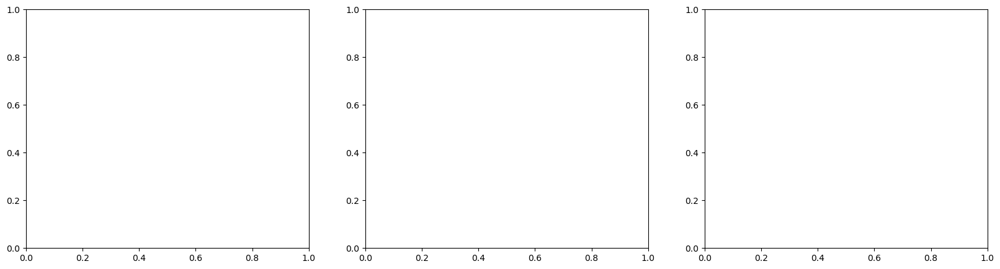

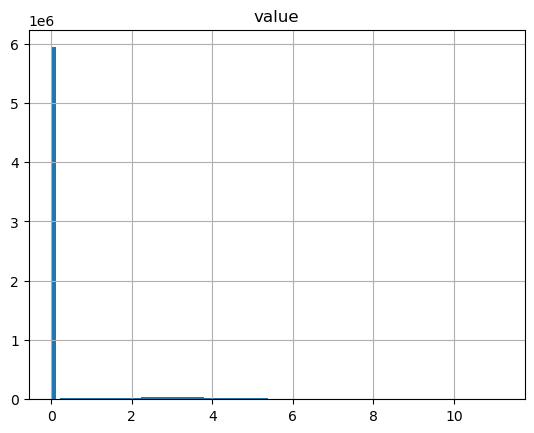

In [6]:
fig, axes = plt.subplots(1, 3, figsize=(20,5))


for i, assembly in enumerate(assemblies):
    assembly="ce11"
    df = dfs[assembly].copy()
    print(df.max(axis="rows"))
    df.values[:] = np.log1p(df.values)
    df = df.melt(ignore_index=False, var_name="stage")
    print(df)
    df.hist(bins=100)
    
#     ax = sns.histplot(
#         x="value", 
#         data=df,
# #         hue="stage",
#         bins=10,
#         ax=axes[i],
#         kde=False,
#         histtype='step'
#     ).set(title=f"{assembly}: spearman correlation within stage")
# #     axes[i].xaxis.set_tick_params(rotation=45)
    break


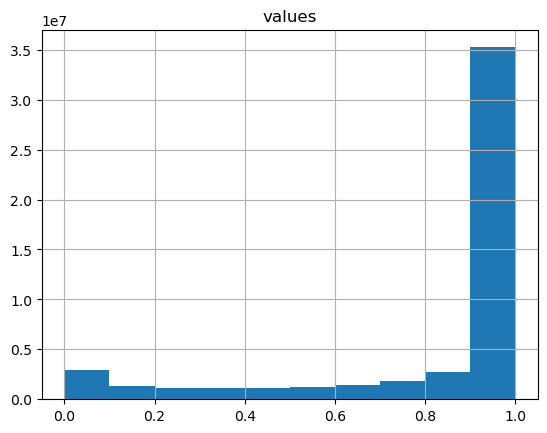

In [41]:
import pandas as pd
import numpy as np

df = pd.DataFrame({
  'values': np.random.beta(0.5, 0.1, size=50000000)
})
hist = df.hist(bins=10)

In [42]:
for assembly in assemblies:
    stage2samples = {
        stage: [x for x in dfs[assembly].columns if stage in x] for stage in assembly_stages[assembly]
    }
    stage2samples = {key: len(value) for key, value in stage2samples.items()}
    print(assembly, stage2samples)

ce11 {'mpf_0': 23, 'mpf_60': 23, 'mpf_180': 23, 'mpf_270': 23, 'mpf_440': 23, 'mpf_650': 23, 'mpf_830': 23}
BDGP6.32 {'embryo2-3h': 11, 'embryo5-6h': 24, 'embryo8-9h': 27, 'embryo11-12h': 14, 'embryo14-15h': 21, 'embryo17-18h': 18, 'embryo20-21h': 21, 'embryo23-24h': 14}
GRCz11 {'1-cell': 11, '2-cell': 12, '128-cell': 12, '1k-cell': 12, 'Dome': 12, '50pc-epiboly': 12, 'Shield': 11, '75pc-epiboly': 12, '1-4-somites': 12, '14-19-somites': 12, '20-25-somites': 12, 'Prim-5': 12, 'Prim-15': 12, 'Prim-25': 12, 'Long-pec': 12, 'Protruding-mouth': 12, 'Day-4': 12, 'Day-5': 12}


In [60]:
bootstraps = 250
bootstrap_df = []

use_reps = [1, 4]
use_reps = [1]

for assembly in assemblies:st
    stage2samples = {
        stage: [x for x in dfs[assembly].columns if stage in x] for stage in assembly_stages[assembly]
    }
    df = dfs[assembly]
    for nr_reps in use_reps:
        print(assembly, nr_reps)
        for i, (stage1, samples1) in enumerate(stage2samples.items()):
            for j, (stage2, samples2) in enumerate(stage2samples.items()):
                if stage1 != stage2:
                    continue
                samples2 = set(samples2)
                for _ in range(bootstraps):
                    sample1 = set(random.sample(samples1, nr_reps))
                    sample2 = random.sample(list(samples2 - sample1), nr_reps)
                    sample1, sample2 = df[list(sample1)].mean(axis="columns"), df[list(sample2)].mean(axis="columns")
                    rho, pval = scipy.stats.spearmanr(sample1, sample2)
                    bootstrap_df.append([assembly, str(nr_reps), stage1, stage2, rho])

bootstrap_df = pd.DataFrame(bootstrap_df, columns=["assembly", "nr_reps", "stage1", "stage2", "spearman"])
bootstrap_df

ce11 1
BDGP6.32 1
GRCz11 1


,assembly,nr_reps,stage1,stage2,spearman
0,ce11,1,mpf_0,mpf_0,0.815527
1,ce11,1,mpf_0,mpf_0,0.733548
2,ce11,1,mpf_0,mpf_0,0.717568
3,ce11,1,mpf_0,mpf_0,0.782047
4,ce11,1,mpf_0,mpf_0,0.820236
...,...,...,...,...,...
8245,GRCz11,1,Day-5,Day-5,0.888202
8246,GRCz11,1,Day-5,Day-5,0.882754
8247,GRCz11,1,Day-5,Day-5,0.883334
8248,GRCz11,1,Day-5,Day-5,0.879804


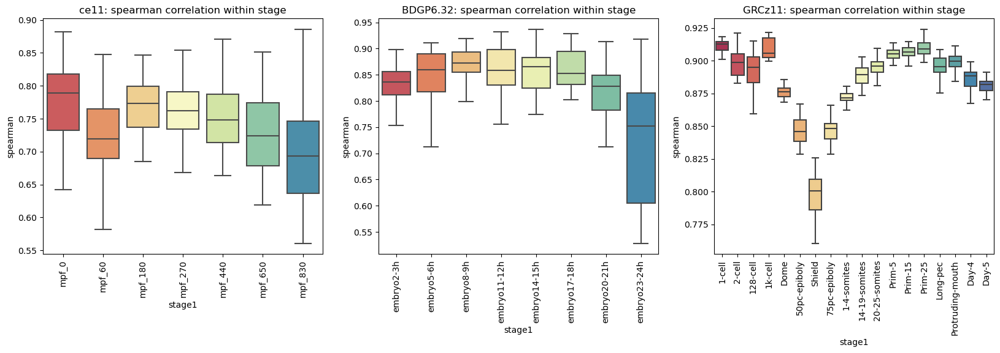

In [62]:
fig, axes = plt.subplots(1, 3, figsize=(20,5), sharey=False)

for i, assembly in enumerate(assemblies):
    df = bootstrap_df[bootstrap_df["assembly"] == assembly]
    df = df[(df['stage1'] == df['stage2'])]
#     df = df[(df["nr_reps"] == str(1)) | (df["nr_reps"] == str(6))]

    palette = sns.color_palette("Spectral", len(assembly_stages[assembly])).as_hex()

    
    ax = sns.boxplot(
        x="stage1", 
        y="spearman",
        data=df,
#         hue="nr_reps",
#         s=0.5
        ax=axes[i],
        palette=palette,
#         ci='sd'
        showfliers=False
    ).set(title=f"{assembly}: spearman correlation within stage")
    axes[i].xaxis.set_tick_params(rotation=90)

/home/sande/miniconda3/envs/phylotypic_hourglass/lib/python3.10/site-packages/seaborn/categorical.py:3543: UserWarning: 26.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/sande/miniconda3/envs/phylotypic_hourglass/lib/python3.10/site-packages/seaborn/categorical.py:3543: UserWarning: 6.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/sande/miniconda3/envs/phylotypic_hourglass/lib/python3.10/site-packages/seaborn/categorical.py:3543: UserWarning: 8.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/sande/miniconda3/envs/phylotypic_hourglass/lib/python3.10/site-packages/seaborn/categorical.py:3543: UserWarning: 16.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.


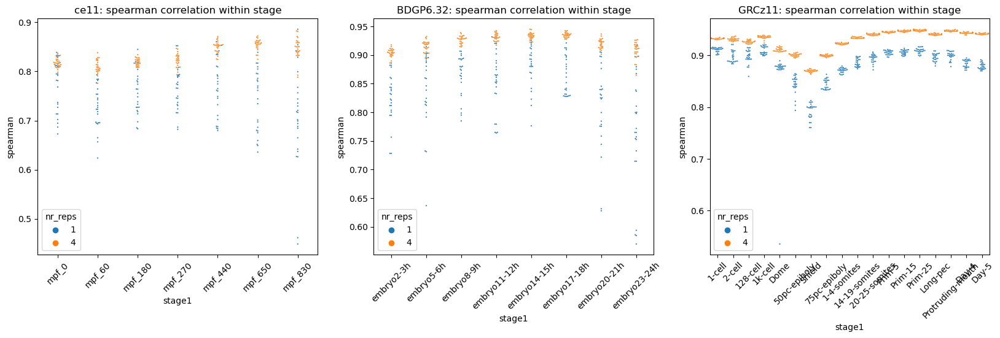

In [45]:
fig, axes = plt.subplots(1, 3, figsize=(20,5))

for i, assembly in enumerate(assemblies):
    df = bootstrap_df[bootstrap_df["assembly"] == assembly]
    df = df[(df['stage1'] == df['stage2'])]

    
    ax = sns.swarmplot(
        x="stage1", 
        y="spearman",
        data=df,
        hue="nr_reps",
        s=1.5,
        ax=axes[i],
#         ci='sd'
#         showfliers=False
    ).set(title=f"{assembly}: spearman correlation within stage")
    axes[i].xaxis.set_tick_params(rotation=45)

/tmp/ipykernel_50125/2485862723.py:15: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  groups = df.groupby(["stage1", "stage2"]).mean()
/tmp/ipykernel_50125/2485862723.py:15: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  groups = df.groupby(["stage1", "stage2"]).mean()
/tmp/ipykernel_50125/2485862723.py:15: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  groups = df.groupby(["stage1", "stage2"]).mean()
/tmp/ipykernel_5012

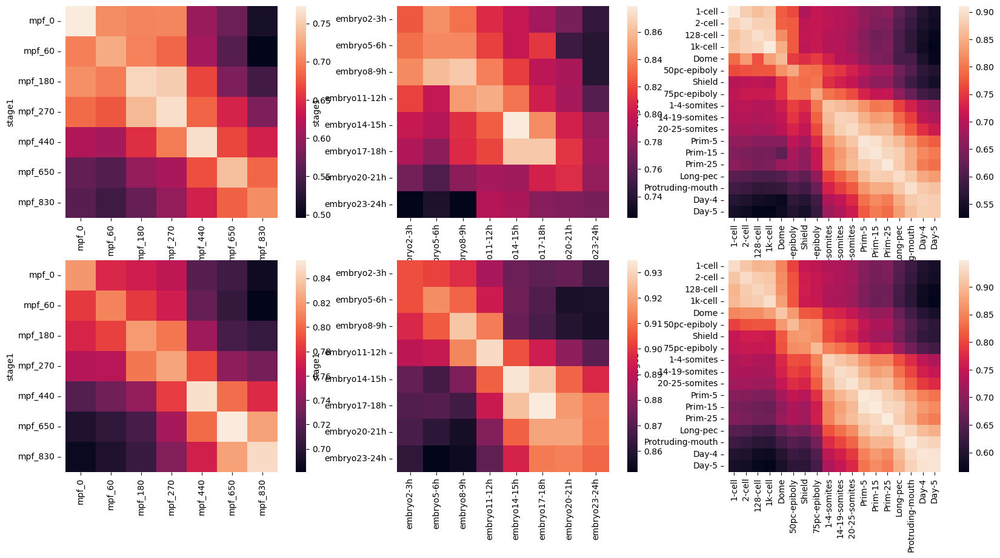

In [46]:
fig, axes = plt.subplots(len(use_reps), 3, figsize=(20,10))


# axes[0, 0].get_shared_y_axes().join(*list(axes[1:, 0]))
# axes[0, 1].get_shared_y_axes().join(*list(axes[1:, 1]))
# axes[0, 2].get_shared_y_axes().join(*list(axes[1:, 2]))


species_min = {assembly: 1 for assembly in assemblies}
species_max = {assembly: 0 for assembly in assemblies}

for i, nr_reps in enumerate(use_reps):
    for assembly_nr, assembly in enumerate(assemblies):
        df = bootstrap_df[(bootstrap_df["assembly"] == assembly) & (bootstrap_df["nr_reps"] == str(nr_reps))]
        groups = df.groupby(["stage1", "stage2"]).mean()
        pairwise = groups.reset_index().pivot(index="stage1", columns="stage2")
        pairwise.columns = [x[1] for x in pairwise.columns]
        species_min[assembly] = min([species_min[assembly], np.min(pairwise.values)])
        species_max[assembly] = max([species_max[assembly], np.max(pairwise.values)])

for i, nr_reps in enumerate(use_reps):
    for assembly_nr, assembly in enumerate(assemblies):
        df = bootstrap_df[(bootstrap_df["assembly"] == assembly) & (bootstrap_df["nr_reps"] == str(nr_reps))]
        groups = df.groupby(["stage1", "stage2"]).mean()
        pairwise = groups.reset_index().pivot(index="stage1", columns="stage2")
        pairwise.columns = [x[1] for x in pairwise.columns]
        
        sns.heatmap(pairwise.loc[assembly_stages[assembly], assembly_stages[assembly]], ax=axes[i, assembly_nr]) #, vmin=species_min[assembly], vmax=species_max[assembly])
        axes[i, assembly_nr].axis('equal')

In [63]:
# first we make the sqlite database
# you can ignore this piece of code
import os
import sqlite3
import urllib.request, json 

orthogroups = pd.read_csv("../data/count_tables/orthogroups.tsv", sep="\t", comment="#", index_col=0)

# orthogroups = pd.read_csv("da/orthogroups_new.tsv", sep="\t", comment="#", index_col=0)


db = "db.sqlite3"
if os.path.exists(db):
    os.remove(db)

conn = sqlite3.connect(db)
conn.execute(
    """
    CREATE TABLE IF NOT EXISTS orthogroups
    (
    id integer PRIMARY KEY, 
    orthogroup text UNIQUE NOT NULL
    )
    """
)

conn.execute(
    """
    CREATE TABLE IF NOT EXISTS assemblies
    (
    id integer PRIMARY KEY, 
    assembly text
    )
    """
)

conn.execute(
    """
    CREATE TABLE IF NOT EXISTS genes
    (
    id integer PRIMARY KEY,
    gene_name text,
    gene_id text,
    assembly NOT NULL,
    orthogroup,
    FOREIGN KEY (orthogroup) REFERENCES orthogroups (id),
    FOREIGN KEY (assembly) REFERENCES assemblies (assembly)
    )
    """
)
for orthogroup in orthogroups.index:
    conn.execute(f"INSERT INTO orthogroups VALUES(NULL, '{orthogroup}')")
conn.execute(f"INSERT INTO orthogroups VALUES(NULL, 'UNASSIGNED')")

# all assemblies
for assembly in assemblies:
    conn.execute(f"INSERT INTO assemblies VALUES(NULL, '{assembly}')")

# all genes per species
for assembly in assemblies:
    for orthogroup, genes in zip(
        orthogroups.index, orthogroups[f"{assembly}.pep"]
    ):
        if isinstance(genes, float) and np.isnan(genes):
            continue

        for gene in genes.split(", "):
            gene_name, gene_id = gene.split("|")
            #                 print(gene, gene_name, gene_id, gene_name != ".", orthogroup)
            if gene_name not in dfs[assembly].index and gene_id not in dfs[assembly].index:
                continue
            if gene_name != ".":
                conn.execute(
                    f"INSERT INTO genes VALUES(NULL, '{gene_name}', '{gene_id}', '{assembly.replace('.', '')}', '{orthogroup}')"
                )
            else:
                conn.execute(
                    f"INSERT INTO genes VALUES(NULL, NULL, '{gene_id}', '{assembly.replace('.', '')}', '{orthogroup}')"
                )

conn.commit()
cur = conn.cursor()

cur.execute("CREATE INDEX idx_name ON genes (gene_name, assembly)")
cur.execute("CREATE INDEX idx_id ON genes (gene_id, assembly)")
cur.execute("CREATE INDEX idx_gene ON genes (gene_name)")
cur.execute("CREATE INDEX idx_orthogroup ON orthogroups (orthogroup)")
cur.execute("CREATE INDEX idx_orthogroup_assembly ON genes (orthogroup, assembly)")
cur.execute("CREATE INDEX idx_assembly_orthogroup ON genes (assembly, orthogroup)")
conn.commit()

In [64]:
combos = dict()

for i, assembly_X in enumerate(assemblies):
    for j, assembly_Y in enumerate(assemblies):
        if j > i:
            continue

        orthogroups_seen, genes_X, genes_Y = [], [], []
        for orthogroup, *_ in set(cur.execute(f"""
        SELECT genes.orthogroup from 
        ORTHOGROUPS INNER JOIN genes ON ORTHOGROUPS.orthogroup=genes.orthogroup
        WHERE genes.assembly='{assembly_X.replace('.', '')}' OR genes.assembly='{assembly_Y.replace('.', '')}'""").fetchall()):
            genes1 = tuple({gene for genes in cur.execute(f"SELECT gene_id FROM genes WHERE assembly='{assembly_X.replace('.', '')}' AND orthogroup='{orthogroup}'").fetchall() for gene in genes if gene is not None})
            genes2 = tuple({gene for genes in cur.execute(f"SELECT gene_id FROM genes WHERE assembly='{assembly_Y.replace('.', '')}' AND orthogroup='{orthogroup}'").fetchall() for gene in genes if gene is not None})
            if len(genes1) == 0 or len(genes2) == 0:
                continue
                
            gene1 = random.choice(genes1)
            gene2 = random.choice(genes2)

            orthogroups_seen.append(orthogroup)
            genes_X.append(gene1)
            genes_Y.append(gene2)
            
        df_X = dfs[assembly_X].loc[genes_X]
        df_Y = dfs[assembly_Y].loc[genes_Y]
        
        # TODO, do we do this? If so, then also for normal TPMs
        # make sure to quantile normalize, otherwise distribution is not equal
#         df_X = qnorm.quantile_normalize(df_X)
#         df_Y = qnorm.quantile_normalize(df_Y)
        
        df_X.index = pd.MultiIndex.from_arrays([df_X.index, orthogroups_seen], names=["gene", "orthogroup"])
        df_Y.index = pd.MultiIndex.from_arrays([df_Y.index, orthogroups_seen], names=["gene", "orthogroup"])
        
        combos[assembly_X, assembly_Y] = (df_X, df_Y)
        combos[assembly_Y, assembly_X] = (df_Y, df_X)

In [65]:
# TODO
bootstraps = 100
bootstrap_df = []

use_reps = [1]

for i, assembly_X in enumerate(assemblies):
    stage2samples_X = {
        stage: [x for x in dfs[assembly_X].columns if stage in x] for stage in assembly_stages[assembly_X]
    }
    for j, assembly_Y in enumerate(assemblies):
        if j > i:
            continue

        stage2samples_Y = {
            stage: [x for x in dfs[assembly_Y].columns if stage in x] for stage in assembly_stages[assembly_Y]
        }
        df_X, df_Y = combos[assembly_X, assembly_Y]
        for nr_reps in use_reps:
            print(assembly_X, assembly_Y, nr_reps)
            for k, (stage1, samples1) in enumerate(stage2samples_X.items()):
                for l, (stage2, samples2) in enumerate(stage2samples_Y.items()):
                    samples2 = set(samples2)
                    for _ in range(bootstraps):
                        sample1 = set(random.sample(samples1, nr_reps))
                        sample2 = random.sample(list(samples2 - sample1), nr_reps)
                        sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
                        rho, pval = scipy.stats.spearmanr(sample1, sample2)
                        bootstrap_df.append([assembly_X, assembly_Y, str(nr_reps), stage1, stage2, rho])

bootstrap_df = pd.DataFrame(bootstrap_df, columns=["assembly_X", "assembly_Y", "nr_reps", "stage1", "stage2", "spearman"])
bootstrap_df

ce11 ce11 1


/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

BDGP6.32 ce11 1


/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

BDGP6.32 BDGP6.32 1


/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

GRCz11 ce11 1


/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

GRCz11 BDGP6.32 1


/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

GRCz11 GRCz11 1


/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/1589932264.py:27: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  sample1, sample2 = df_X[sample1].mean(axis="columns"), df_Y[sample2].mean(axis="columns")
/tmp/ipykernel_50125/158

,assembly_X,assembly_Y,nr_reps,stage1,stage2,spearman
0,ce11,ce11,1,mpf_0,mpf_0,0.843057
1,ce11,ce11,1,mpf_0,mpf_0,0.861866
2,ce11,ce11,1,mpf_0,mpf_0,0.779922
3,ce11,ce11,1,mpf_0,mpf_0,0.773423
4,ce11,ce11,1,mpf_0,mpf_0,0.745130
...,...,...,...,...,...,...
76295,GRCz11,GRCz11,1,Day-5,Day-5,0.740936
76296,GRCz11,GRCz11,1,Day-5,Day-5,0.738753
76297,GRCz11,GRCz11,1,Day-5,Day-5,0.752682
76298,GRCz11,GRCz11,1,Day-5,Day-5,0.741457


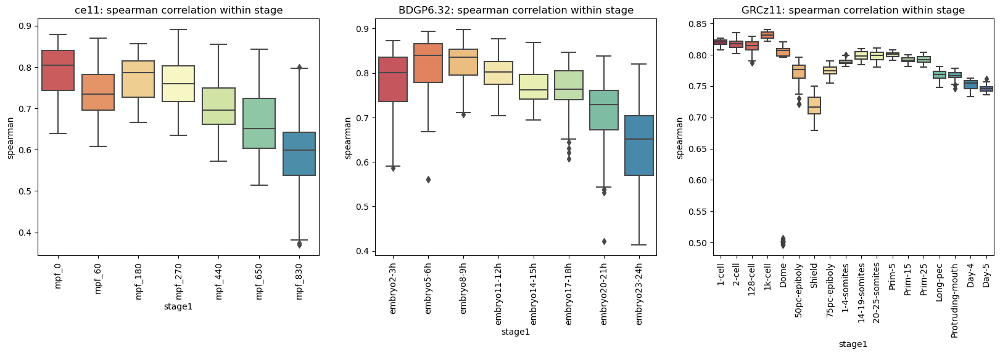

In [67]:
fig, axes = plt.subplots(1, 3, figsize=(20,5), sharey=False)

for i, assembly in enumerate(assemblies):
    df = bootstrap_df[(bootstrap_df["assembly_X"] == assembly) & (bootstrap_df["assembly_Y"] == assembly)]
    df = df[(df['stage1'] == df['stage2'])]
#     df = df[(df["nr_reps"] == str(1)) | (df["nr_reps"] == str(6))]

    palette = sns.color_palette("Spectral", len(assembly_stages[assembly])).as_hex()

    ax = sns.boxplot(
        x="stage1", 
        y="spearman",
        data=df,
#         hue="nr_reps",
#         s=0.5,
        ax=axes[i],
        palette=palette,
#         ci='sd'
#         showfliers=False
    ).set(title=f"{assembly}: spearman correlation within stage")
    axes[i].xaxis.set_tick_params(rotation=90)

/tmp/ipykernel_50125/3788205356.py:16: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  groups = df.groupby(["stage1", "stage2"]).mean()


KeyError: "None of [Index(['mpf_0', 'mpf_60', 'mpf_180', 'mpf_270', 'mpf_440', 'mpf_650',\n       'mpf_830'],\n      dtype='object')] are in the [index]"

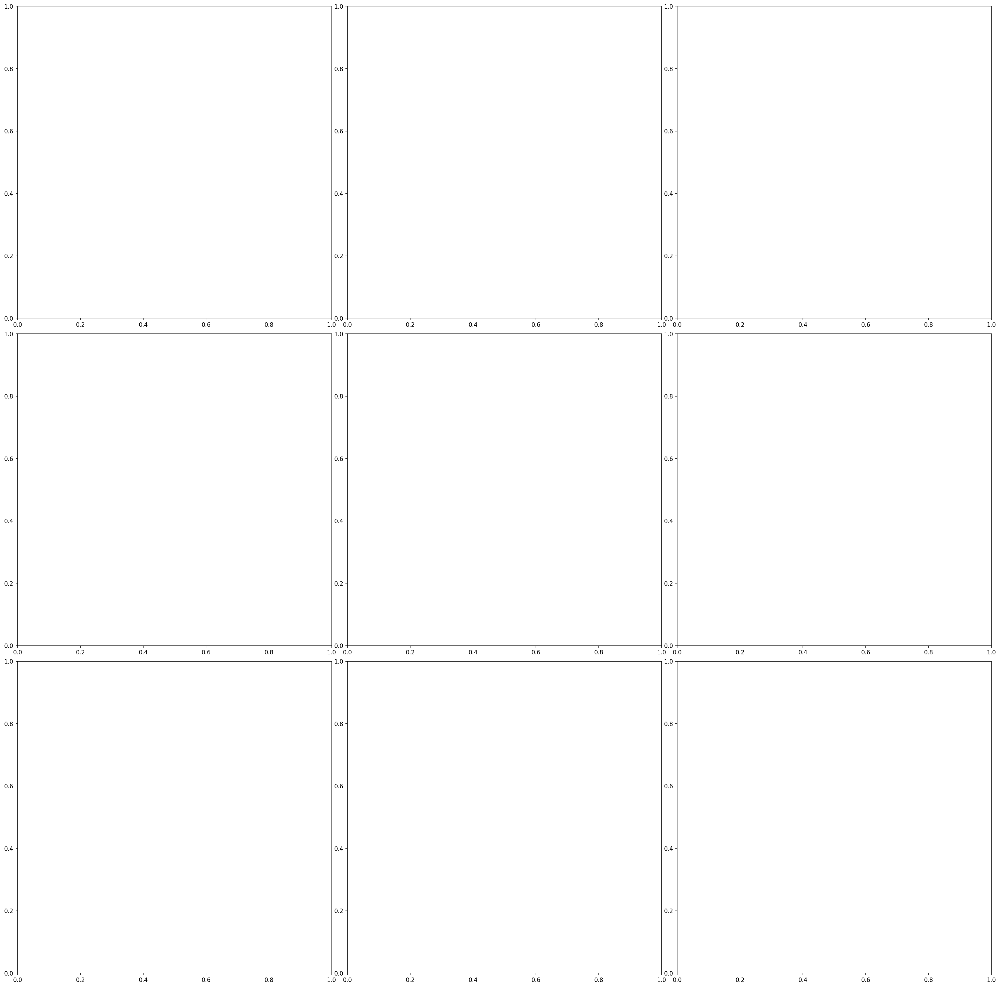

In [52]:
fig, axes = plt.subplots(figsize=(30, 30), nrows=len(assemblies), ncols=len(assemblies), dpi=150)
plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.05, hspace=0.05)


nr_reps = 5

for i, assembly_X in enumerate(assemblies):
    for j, assembly_Y in enumerate(assemblies):
        ax = axes[i, j]

        if j > i: 
            ax.axis('off')
            continue

        df = bootstrap_df[(bootstrap_df["assembly_X"] == assembly_X) & (bootstrap_df["assembly_Y"] == assembly_Y) & (bootstrap_df["nr_reps"] == str(nr_reps))]
        groups = df.groupby(["stage1", "stage2"]).mean()
        pairwise = groups.reset_index().pivot(index="stage1", columns="stage2")
        pairwise.columns = [x[1] for x in pairwise.columns]
        pairwise.index = [x for x in pairwise.index]
        
        mask = np.zeros(pairwise.shape)
        if i == j:
            mask = np.triu(pairwise, k=1)

        sns.heatmap(
            pairwise.loc[assembly_stages[assembly_X], assembly_stages[assembly_Y]],
            ax=axes[i, j],
            annot=True,
            mask=mask
        )
#         axes[i, j].axis('equal')
        if j != 0:
            ax.set_yticks([])
#             ax.set_ylabel(assembly_X, fontsize=18)
        if i != len(assemblies) - 1:
            ax.set_xticks([])
#             ax.set_xlabel(assembly_Y, fontsize=18)



In [ ]:
fig, axes = plt.subplots(figsize=(30, 30), nrows=len(assemblies), ncols=len(assemblies), dpi=150)
plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.05, hspace=0.05)


nr_reps = 5

for i, assembly_X in enumerate(assemblies):
    for j, assembly_Y in enumerate(assemblies):
        ax = axes[i, j]

        if j > i: 
            ax.axis('off')
            continue

        df_X = bootstrap_df[(bootstrap_df["assembly_X"] == assembly_X) & (bootstrap_df["assembly_Y"] == assembly_X) & (bootstrap_df["nr_reps"] == str(nr_reps))]
        df_X = df_X[df_X["stage1"] == df_X["stage2"]]
        df_Y = bootstrap_df[(bootstrap_df["assembly_X"] == assembly_Y) & (bootstrap_df["assembly_Y"] == assembly_Y) & (bootstrap_df["nr_reps"] == str(nr_reps))]
        df_Y = df_Y[df_Y["stage1"] == df_Y["stage2"]]
        groups_X = df_X.groupby(["stage1"]).mean()
        groups_Y = df_Y.groupby(["stage1"]).mean()

        pairwise = groups_X.dot(groups_Y.T)
        pairwise.columns = [x for x in pairwise.columns]
        pairwise.index = [x for x in pairwise.index]
        
        mask = np.zeros(pairwise.shape)
        if i == j:
            mask = np.triu(pairwise, k=1)

        sns.heatmap(
            pairwise.loc[assembly_stages[assembly_X], assembly_stages[assembly_Y]],
            ax=axes[i, j],
            annot=True,
            mask=mask
        )
        if j != 0:
            ax.set_yticks([])
#             ax.set_ylabel(assembly_X, fontsize=18)
        if i != len(assemblies) - 1:
            ax.set_xticks([])
#             ax.set_xlabel(assembly_Y, fontsize=18)



                 mpf_0   mpf_180   mpf_270   mpf_440    mpf_60   mpf_650  \
embryo11-12h  0.767186  0.763652  0.761455  0.740349  0.749557  0.718325   
embryo14-15h  0.752561  0.749094  0.746940  0.726236  0.735269  0.704632   
embryo17-18h  0.749893  0.746439  0.744292  0.723661  0.732662  0.702134   
embryo2-3h    0.754443  0.750967  0.748807  0.728052  0.737107  0.706394   
embryo20-21h  0.728072  0.724718  0.722634  0.702603  0.711342  0.681702   
embryo23-24h  0.716447  0.713147  0.711096  0.691385  0.699985  0.670818   
embryo5-6h    0.773266  0.769704  0.767490  0.746216  0.755498  0.724018   
embryo8-9h    0.780806  0.777210  0.774974  0.753493  0.762865  0.731078   

               mpf_830  
embryo11-12h  0.701787  
embryo14-15h  0.688409  
embryo17-18h  0.685969  
embryo2-3h    0.690130  
embryo20-21h  0.666008  
embryo23-24h  0.655374  
embryo5-6h    0.707349  
embryo8-9h    0.714247  


<AxesSubplot:>

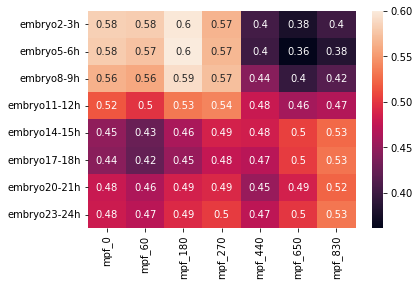

In [19]:
nr_reps = 5

assembly_X = "BDGP6.32"
assembly_Y = "ce11"

df_X = bootstrap_df[(bootstrap_df["assembly_X"] == assembly_X) & (bootstrap_df["assembly_Y"] == assembly_X) & (bootstrap_df["nr_reps"] == str(nr_reps))]
df_X = df_X[df_X["stage1"] == df_X["stage2"]]
df_Y = bootstrap_df[(bootstrap_df["assembly_X"] == assembly_Y) & (bootstrap_df["assembly_Y"] == assembly_Y) & (bootstrap_df["nr_reps"] == str(nr_reps))]
df_Y = df_Y[df_Y["stage1"] == df_Y["stage2"]]
groups_X = df_X.groupby(["stage1"]).mean()
groups_Y = df_Y.groupby(["stage1"]).mean()

pairwise = groups_X.dot(groups_Y.T)
pairwise.columns = [x for x in pairwise.columns]
pairwise.index = [x for x in pairwise.index]
vals_XY = pairwise

df = bootstrap_df[(bootstrap_df["assembly_X"] == assembly_X) & (bootstrap_df["assembly_Y"] == assembly_Y) & (bootstrap_df["nr_reps"] == str(nr_reps))]
groups = df.groupby(["stage1", "stage2"]).mean()
pairwise = groups.reset_index().pivot(index="stage1", columns="stage2")
pairwise.columns = [x[1] for x in pairwise.columns]
pairwise.index = [x for x in pairwise.index]
vals_X_Y = pairwise

print(vals_XY)
pairwise = vals_X_Y.loc[assembly_stages[assembly_X], assembly_stages[assembly_Y]] / vals_XY.loc[assembly_stages[assembly_X], assembly_stages[assembly_Y]]
sns.heatmap(pairwise, annot=True,)

In [39]:
assembly_X = "BDGP6.32"
assembly_Y = "ce11"


all_reps = []
stage2samples_X = {
    stage: [x for x in dfs[assembly_X].columns if stage in x] for stage in assembly_stages[assembly_X]
}
stage2samples_Y = {
    stage: [x for x in dfs[assembly_Y].columns if stage in x] for stage in assembly_stages[assembly_Y]
}
df_X, df_Y = combos[assembly_X, assembly_Y]
for k, (stage1, samples1) in enumerate(stage2samples_X.items()):
    for l, (stage2, samples2) in enumerate(stage2samples_Y.items()):
        sample1 = df_X[random.choice(samples1)]
        sample2 = df_Y[random.choice(samples2)]
#         sample1, sample2 = df_X[samples1].mean(axis="columns"), df_Y[samples2].mean(axis="columns")
        rho, pval = scipy.stats.spearmanr(sample1, sample2)
        all_reps.append([assembly_X, assembly_Y, stage1, stage2, rho])

all_reps = pd.DataFrame(all_reps, columns=["assembly_X", "assembly_Y", "stage1", "stage2", "spearman"])
# all_reps

<AxesSubplot:xlabel='stage2', ylabel='stage1'>

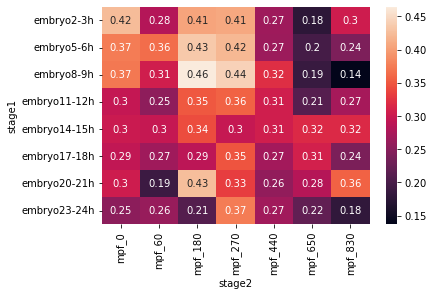

In [40]:
all_rep = all_reps.pivot(index="stage1", columns="stage2")["spearman"].loc[assembly_stages[assembly_X], assembly_stages[assembly_Y]]
sns.heatmap(all_rep, annot=True,)


In [22]:
vals_X_Y

,mpf_0,mpf_180,mpf_270,mpf_440,mpf_60,mpf_650,mpf_830
embryo11-12h,0.395344,0.406703,0.410165,0.354621,0.373208,0.329866,0.327065
embryo14-15h,0.336593,0.345857,0.363240,0.351433,0.313304,0.355816,0.361422
embryo17-18h,0.332523,0.337751,0.354914,0.340027,0.310025,0.352579,0.363708
embryo2-3h,0.439574,0.448654,0.423734,0.294069,0.428083,0.266783,0.276495
embryo20-21h,0.349021,0.352205,0.355302,0.317503,0.329391,0.331447,0.347874
embryo23-24h,0.344785,0.351354,0.357477,0.326997,0.329528,0.335036,0.348528
embryo5-6h,0.448748,0.461872,0.435963,0.298419,0.434148,0.261574,0.271441
embryo8-9h,0.440437,0.459562,0.443923,0.333748,0.425985,0.289209,0.296659


In [23]:
pairwise.melt(ignore_index=False)

,variable,value
embryo2-3h,mpf_0,0.582648
embryo5-6h,mpf_0,0.580329
embryo8-9h,mpf_0,0.564080
embryo11-12h,mpf_0,0.515317
embryo14-15h,mpf_0,0.447263
embryo17-18h,mpf_0,0.443428
embryo20-21h,mpf_0,0.479378
embryo23-24h,mpf_0,0.481243
embryo2-3h,mpf_60,0.580761
embryo5-6h,mpf_60,0.574652


In [24]:
pairwise

,mpf_0,mpf_60,mpf_180,mpf_270,mpf_440,mpf_650,mpf_830
embryo2-3h,0.582648,0.580761,0.597434,0.565878,0.403912,0.377669,0.400642
embryo5-6h,0.580329,0.574652,0.600065,0.568037,0.399909,0.361280,0.383744
embryo8-9h,0.564080,0.558402,0.591297,0.572823,0.442934,0.395592,0.415345
embryo11-12h,0.515317,0.497904,0.532577,0.538659,0.478992,0.459216,0.466046
embryo14-15h,0.447263,0.426108,0.461701,0.486305,0.483910,0.504967,0.525011
embryo17-18h,0.443428,0.423149,0.452483,0.476848,0.469870,0.502154,0.530211
embryo20-21h,0.479378,0.463055,0.485989,0.491677,0.451896,0.486205,0.522327
embryo23-24h,0.481243,0.470765,0.492680,0.502712,0.472959,0.499443,0.531800


In [25]:
dfs["BDGP6.32"]

,embryo2-3h_E1_1_B12,embryo2-3h_E1_2_F3,embryo2-3h_E1_2_F2,embryo2-3h_E1_2_G10,embryo2-3h_E1_2_F7,embryo2-3h_E2_D10,embryo2-3h_E2_H1,embryo2-3h_E2_E10,embryo2-3h_E2_H11,embryo2-3h_E3_A12,...,embryo23-24h_E2_B11,embryo23-24h_E2_C2,embryo23-24h_E2_H5,embryo23-24h_E2_H4,embryo23-24h_E2_E3,embryo23-24h_E3_C6,embryo23-24h_E3_B12,embryo23-24h_E3_D12,embryo23-24h_E3_E1,embryo23-24h_E3_A6
gene,,,,,,,,,,,,,,,,,,,,,
FBgn0000003,0.000000,0.706427,0.000000,0.000000,0.000000,0.617500,1.989342,0.000000,0.000000,1.445529,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
FBgn0000008,0.089021,0.122298,0.000000,0.032892,2.420216,0.427611,0.038266,0.538243,3.480117,0.917592,...,0.877866,0.000000,0.709755,1.278557,0.000000,0.000000,0.000000,2.474538,0.000000,0.000000
FBgn0000014,1.091833,0.559987,4.067065,0.129091,0.431762,0.174820,1.764692,2.992673,2.682942,4.174263,...,3.836934,0.000000,4.797449,3.327171,1.289119,0.000000,24.838131,0.000000,0.000000,0.000000
FBgn0000015,0.421645,1.004047,2.243746,0.727017,2.709495,0.045008,0.579992,0.679831,4.395579,0.895567,...,0.151199,1.698448,0.647443,1.088294,0.355595,0.276597,2.422224,0.000000,0.000000,6.201077
FBgn0000017,0.183077,0.000000,1.461339,0.027057,0.542978,0.864746,0.362006,0.295180,0.613460,0.308794,...,1.017575,0.000000,3.016604,0.754529,0.926388,1.441168,0.000000,2.798958,1.837347,0.605809
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
RR51048_transposable_element,0.049795,0.000000,0.000000,0.000000,0.123070,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.089280,0.000000,0.000000,0.062189,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
RR51093_transposable_element,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.109399,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
RR51475_transposable_element,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [26]:
# assemblies = ["ASM223467v1", "ce11", "BDGP6.32"]

assembly = "BDGP6.32"
df = dfs[assembly]
# df, df = combos[assembly, assembly]
df
df = pd.DataFrame(scipy.stats.entropy(df), index=df.columns, columns=["entropy"])
df["stage"] = [idx.split("_")[0] for idx in df.index]
df

,entropy,stage
embryo2-3h_E1_1_B12,6.044007,embryo2-3h
embryo2-3h_E1_2_F3,6.549999,embryo2-3h
embryo2-3h_E1_2_F2,6.946670,embryo2-3h
embryo2-3h_E1_2_G10,5.805006,embryo2-3h
embryo2-3h_E1_2_F7,6.362638,embryo2-3h
...,...,...
embryo23-24h_E3_C6,6.474227,embryo23-24h
embryo23-24h_E3_B12,6.503775,embryo23-24h
embryo23-24h_E3_D12,6.359735,embryo23-24h
embryo23-24h_E3_E1,6.514873,embryo23-24h


<AxesSubplot:xlabel='stage', ylabel='entropy'>

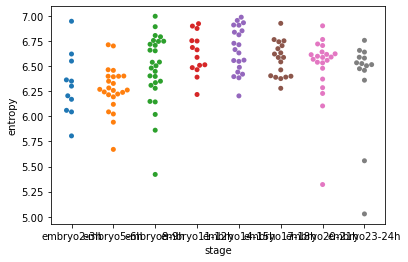

In [27]:
sns.swarmplot(
        x="stage", 
        y="entropy",
        data=df
)

ASM223467v1
['stage15', 'stage23.5', 'stage28', 'Hatch']
                                   mean    variance
gene               stage                           
ENSORLG00000000002 Hatch      30.121752  284.531132
                   stage15    45.499414  161.839520
                   stage23.5  47.638639   51.594184
                   stage28    58.993101   87.980674
ENSORLG00000000003 Hatch       9.584468   49.598980
...                                 ...         ...
ENSORLG00000030657 stage28     0.000000    0.000000
ENSORLG00000030658 Hatch      23.877431   95.705174
                   stage15     5.334795   12.526432
                   stage23.5   7.473425    4.569128
                   stage28    14.103872   19.580601

[97460 rows x 2 columns]
ce11
['mpf_0', 'mpf_60', 'mpf_180', 'mpf_270', 'mpf_440', 'mpf_650', 'mpf_830']
                   mean    variance
gene   stage                       
21ur-1 0       0.000000    0.000000
       180     0.000000    0.000000
       270     0.

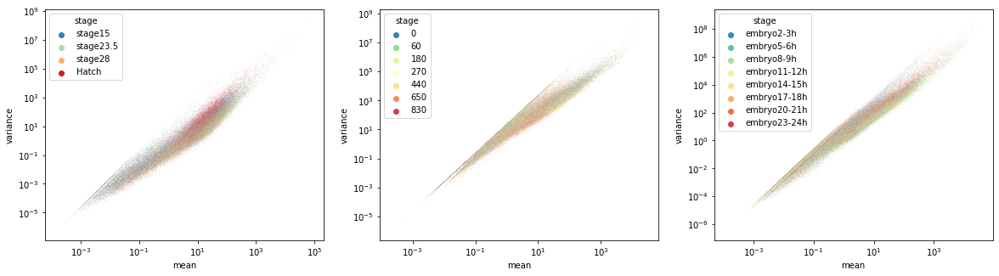

In [28]:
fig, axes = plt.subplots(1, 3, figsize=(20,5))

idxs = {
    "ASM223467v1": 1,
    "ce11": 2,
    "BDGP6.32": 0
}

for i, assembly in enumerate(assemblies):
    print(assembly)
    df = dfs[assembly].copy()
    molten_df = df.melt(ignore_index=False, var_name="sample")
    molten_df["stage"] = molten_df["sample"].str.split('_', expand=True)[idxs[assembly]]
    
    mean = molten_df.groupby(["gene", "stage"]).mean()
    var = molten_df.groupby(["gene", "stage"]).var()
    df = pd.concat([mean, var], axis="columns")
    df.columns=["mean", "variance"]
    
    print(assembly_stages[assembly])
    print(df)
    sns.scatterplot(
        x="mean",
        y="variance",
        data=df,
        hue="stage",
        ax=axes[i],
        palette=assembly_cols[i],
        s=0.1,
        hue_order=[stage.split("_")[-1] for stage in assembly_stages[assembly]]
    )
    axes[i].set_yscale('log')
    axes[i].set_xscale('log')
    
#     break